# Introduction

Our research question intends to explore the interrelationship between transportation and housing affordability. We will use use the American Community Survey Data from Social Explorer to analyze if there are potential correlations between the use of transportation mode and rent across Los Angeles County. By analysing both data sets from 2010 and 2018, we can infer if public transit expansion may have an impact in housing affordabilty levels across different Census Tracts. We also import LA Tracts data from the Los Angeles Times and LA Metro lines from the Metro developer portal.

We use the following data: 
From __American Community Survey__ 2010 and 2018:
* Transit use by workers 16+
* Median Gross Rent
* Housing Units

From __LA Times__ Data Sets:
* LA County census tract boundaries

From __LA Metro__ developer portal:
* Metro stations

# Import data

We cleaned up our data in previous notebooks by doing these steps:
* Importing 2010 data for housing units, median gross rent, and transit use
* Importing 2018 data for housing units, median gross rent, and transit use
* Removing extraneous columns
* Combining the two datasets
* Adding columns to show the change in each variable
* Removing any census tracts with fewer than 100 housing units in 2010, as many were outliers

In [1]:
#import pandas and numpy

import pandas as pd
import numpy as np

In [2]:
# Read in our edited data, using the index column already in the data

df = pd.read_csv('Data/final_data.csv', index_col='Unnamed: 0', dtype=
    {
        'FIPS':str,
        'Geo_STATE':str,
        'Geo_COUNTY': str,
        'Geo_TRACT' : str
    })

In [3]:
# Look at the head of the data

df.head()

,FIPS,Geo_NAME,Geo_QName,Geo_STATE,Geo_COUNTY,Geo_TRACT,2010 Housing Units,2010 Median Gross Rent,2010 Percent Transit,2018 Housing Units,2018 Median Gross Rent,2018 Percent Transit,Change Housing Units,Change Median Rent,Change Percent Transit
0,06037800324,"Census Tract 8003.24 (part), Agoura Hills city...","Census Tract 8003.24 (part), Agoura Hills city...",06,037,800324,2242,2310.0,0.55,2468,2667.0,0.14,0.100803,0.154545,-0.41
1,06037800324,"Census Tract 8003.24 (part), Westlake Village ...","Census Tract 8003.24 (part), Westlake Village ...",06,037,800324,313,2310.0,0.00,2468,2667.0,0.14,6.884984,0.154545,0.14
2,06037800326,"Census Tract 8003.26 (part), Agoura Hills city...","Census Tract 8003.26 (part), Agoura Hills city...",06,037,800326,175,2162.0,0.00,2135,2154.0,0.44,11.200000,-0.003700,0.44
3,06037800326,"Census Tract 8003.26 (part), Westlake Village ...","Census Tract 8003.26 (part), Westlake Village ...",06,037,800326,1346,2310.0,0.00,2135,2154.0,0.44,0.586181,-0.067532,0.44
4,06037800326,"Census Tract 8003.26 (part), Remainder of Agou...","Census Tract 8003.26 (part), Remainder of Agou...",06,037,800326,546,748.0,0.00,2135,2154.0,0.44,2.910256,1.879679,0.44


## Make a Scatter Plot

We start with a simple scatter plot to show the change in Median Rent and Percent Transit to analyze potential correlations between Rent and transit usage. 

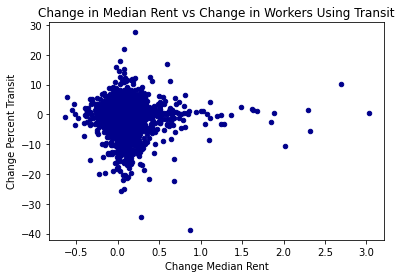

In [4]:
#make a scatter plot of Median Rent and Transit Use, adding a title and changing the color
df.plot.scatter(x = 'Change Median Rent',
               y = 'Change Percent Transit',
               c = 'DarkBlue',
               title = 'Change in Median Rent vs Change in Workers Using Transit')

# Folium Maps

We made Folium maps of the change in transit use and median rent. We updated the cutoff points for the color scales on each map to make it clear where these metrics have changed a slightly or a lot. We also use a new diverging color scale from colorbrewer2.org. 

In [5]:
#import geopandas
import geopandas as gpd

#import LA Tracts data 
tracts = gpd.read_file('Data/LA_Tracts.geojson')

#subset the data because we only need FIPS and geometry
tracts = tracts[['name','geometry']]

#rename the columns
tracts.columns = ['FIPS','geometry']

In [6]:
# create a new dataframe merging our data with the LA census tracts
tracts_data=tracts.merge(df,on="FIPS")

#look at the head
tracts_data.head()

,FIPS,geometry,Geo_NAME,Geo_QName,Geo_STATE,Geo_COUNTY,Geo_TRACT,2010 Housing Units,2010 Median Gross Rent,2010 Percent Transit,2018 Housing Units,2018 Median Gross Rent,2018 Percent Transit,Change Housing Units,Change Median Rent,Change Percent Transit
0,06037101110,"MULTIPOLYGON (((-118.30229 34.25870, -118.3007...","Census Tract 1011.10, Los Angeles city (part),...","Census Tract 1011.10, Los Angeles city (part),...",06,037,101110,1748,1205.0,1.48,1743,1609.0,2.39,-0.002860,0.335270,0.91
1,06037101122,"MULTIPOLYGON (((-118.30333 34.27354, -118.3031...","Census Tract 1011.22, Los Angeles city (part),...","Census Tract 1011.22, Los Angeles city (part),...",06,037,101122,1393,1581.0,1.92,1391,2120.0,0.37,-0.001436,0.340923,-1.55
2,06037101210,"MULTIPOLYGON (((-118.29945 34.25598, -118.2859...","Census Tract 1012.10, Los Angeles city (part),...","Census Tract 1012.10, Los Angeles city (part),...",06,037,101210,2331,1285.0,4.14,2402,1318.0,3.43,0.030459,0.025681,-0.71
3,06037101220,"MULTIPOLYGON (((-118.28592 34.24896, -118.2859...","Census Tract 1012.20, Los Angeles city (part),...","Census Tract 1012.20, Los Angeles city (part),...",06,037,101220,1296,1038.0,0.00,1328,1198.0,3.64,0.024691,0.154143,3.64
4,06037101300,"MULTIPOLYGON (((-118.27247 34.23253, -118.2719...","Census Tract 1013, Los Angeles city (part), Sa...","Census Tract 1013, Los Angeles city (part), Sa...",06,037,101300,1547,1398.0,0.00,1584,2435.0,4.21,0.023917,0.741774,4.21


## Change in Transit Use

In [7]:
# import folium

import folium

In [8]:
# initiate a map centered on LA
m = folium.Map(location=[34.2,-118.2], 
               zoom_start = 9,
               tiles='CartoDB positron', 
               attribution='CartoDB')

# plot chorpleth map of change in transit use
folium.Choropleth(
                  geo_data=tracts_data,                       # geo data
                  data=tracts_data,                           # data          
                  key_on='feature.properties.FIPS',           # key, or merge column
                  columns=['FIPS', 'Change Percent Transit'], # [key, value]
                  fill_color='RdYlBu',                        # using a diverging scale from colorbrewer2.org
                  line_weight=0.1, 
                  fill_opacity=0.6,
                  line_opacity=0.2,                           # line opacity (of the border)
                  legend_name='Change in Transit Use',
                  threshold_scale=[-67, -10, -1, 1, 10, 41],  # change thresholds
                  nan_fill_color = 'lightgray').add_to(m)     # change the ugly black splotches
m

## Change in Median Rent

In [9]:
# sort the dataframe by change in median rent so we can get a sense of the minumum and maximum changes
df.sort_values(by = 'Change Median Rent')

,FIPS,Geo_NAME,Geo_QName,Geo_STATE,Geo_COUNTY,Geo_TRACT,2010 Housing Units,2010 Median Gross Rent,2010 Percent Transit,2018 Housing Units,2018 Median Gross Rent,2018 Percent Transit,Change Housing Units,Change Median Rent,Change Percent Transit
460,06037406902,"Census Tract 4069.02 (part), West Puente Valle...","Census Tract 4069.02 (part), West Puente Valle...",06,037,406902,676,1747.0,3.21,866,628.0,2.25,0.281065,-0.640527,-0.96
1676,06037900505,"Census Tract 9005.05, Lancaster city (part), N...","Census Tract 9005.05, Lancaster city (part), N...",06,037,900505,1395,1490.0,0.00,1371,584.0,5.95,-0.017204,-0.608054,5.95
130,06037543603,"Census Tract 5436.03, West Carson CDP, Compton...","Census Tract 5436.03, West Carson CDP, Compton...",06,037,543603,1514,2310.0,0.00,1537,1031.0,1.61,0.015192,-0.553680,1.61
2362,06037910301,"Census Tract 9103.01 (part), Palmdale city (pa...","Census Tract 9103.01 (part), Palmdale city (pa...",06,037,910301,388,2310.0,0.00,1522,1083.0,3.55,2.922680,-0.531169,3.55
1708,06037901205,"Census Tract 9012.05 (part), Lancaster city (p...","Census Tract 9012.05 (part), Lancaster city (p...",06,037,901205,2316,1991.0,0.97,3921,963.0,0.94,0.693005,-0.516323,-0.03
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2804,06037500100,"Census Tract 5001 (part), Remainder of Whittie...","Census Tract 5001 (part), Remainder of Whittie...",06,037,500100,201,NaN,0.00,1458,1682.0,0.11,6.253731,NaN,0.11
2806,06037500201,"Census Tract 5002.01 (part), La Habra Heights ...","Census Tract 5002.01 (part), La Habra Heights ...",06,037,500201,759,NaN,0.00,2172,2704.0,0.82,1.861660,NaN,0.82
2810,06037501600,"Census Tract 5016 (part), Hacienda Heights CDP...","Census Tract 5016 (part), Hacienda Heights CDP...",06,037,501600,142,NaN,0.00,2290,1320.0,2.22,15.126761,NaN,2.22
2830,06037500403,"Census Tract 5004.03 (part), Remainder of Whit...","Census Tract 5004.03 (part), Remainder of Whit...",06,037,500403,292,NaN,0.00,1084,1726.0,0.61,2.712329,NaN,0.61


In [10]:
# the end of the dataframe has a lot of NaN, so let's look at the data another way
# it's amazing that median rents have stayed constant (or decreased) in about ~25% of tracts!

df['Change Median Rent'].describe()

count    2380.000000
mean        0.100917
std         0.232859
min        -0.640527
25%        -0.006816
50%         0.073740
75%         0.165738
max         3.029586
Name: Change Median Rent, dtype: float64

In [11]:
# initiate a map centered on LA
m_rent = folium.Map(location=[34.2,-118.2], 
               zoom_start = 9,
               tiles='CartoDB positron', 
               attribution='CartoDB')

# plot chorpleth map of change in transit use
folium.Choropleth(
                  geo_data=tracts_data,                       # geo data
                  data=tracts_data,                           # data          
                  key_on='feature.properties.FIPS',           # key, or merge column
                  columns=['FIPS', 'Change Median Rent'],     # [key, value]
                  fill_color='RdYlBu',                        # using a diverging scale from colorbrewer2.org
                  line_weight=0.1, 
                  fill_opacity=0.6,
                  line_opacity=0.2,                           # line opacity (of the border)
                  legend_name='Change in Median Rent',
                  threshold_scale=[-1, -0.5, -0.1, 0.1, 1, 4],  # change thresholds
                  nan_fill_color = 'lightgray').add_to(m_rent)  # change the ugly black splotches

#show the map of change in rent
m_rent

# Autocorrelation

This week we went with autocorrelation since we have tract-based data, rather than the point-based data that would be necessary for a point pattern analysis.

In [12]:
# to import data from LA Data portal
from sodapy import Socrata

# to create spatial data
import geopandas as gpd

# for basemaps
import contextily as ctx

# For spatial statistics
import esda
from esda.moran import Moran, Moran_Local

import splot
from splot.esda import moran_scatterplot, plot_moran, lisa_cluster,plot_moran_simulation

import libpysal as lps

# Graphics
import matplotlib.pyplot as plt
import plotly.express as px

In [13]:
# calculate spatial weight

wq =  lps.weights.KNN.from_dataframe(tracts_data,k=8)
wq.transform = 'r'

In [14]:
# let's add lag for all three data columns that we have

tracts_data['transit_lag'] = lps.weights.lag_spatial(wq, tracts_data['Change Percent Transit'])
tracts_data['rent_lag'] = lps.weights.lag_spatial(wq, tracts_data['Change Median Rent'])
tracts_data['housing_lag'] = lps.weights.lag_spatial(wq, tracts_data['Change Housing Units'])

In [15]:
# check the new columns

tracts_data.sample(3)

,FIPS,geometry,Geo_NAME,Geo_QName,Geo_STATE,Geo_COUNTY,Geo_TRACT,2010 Housing Units,2010 Median Gross Rent,2010 Percent Transit,2018 Housing Units,2018 Median Gross Rent,2018 Percent Transit,Change Housing Units,Change Median Rent,Change Percent Transit,transit_lag,rent_lag,housing_lag
1632,06037531604,"MULTIPOLYGON (((-118.16675 34.02304, -118.1660...","Census Tract 5316.04, East Los Angeles CDP (pa...","Census Tract 5316.04, East Los Angeles CDP (pa...",06,037,531604,958,958.0,24.47,954,1090.0,8.22,-0.004175,0.137787,-16.25,-7.8450,0.056803,0.008092
1835,06037552100,"MULTIPOLYGON (((-118.09994 33.90216, -118.0999...","Census Tract 5521, Norwalk city, Downey-Norwal...","Census Tract 5521, Norwalk city, Downey-Norwal...",06,037,552100,1935,601.0,2.57,1928,1114.0,2.74,-0.003618,0.853577,0.17,-1.8750,0.101022,-0.015966
1562,06037502402,"MULTIPOLYGON (((-118.09619 33.96930, -118.0958...","Census Tract 5024.02, Pico Rivera city (part),...","Census Tract 5024.02, Pico Rivera city (part),...",06,037,502402,1020,1440.0,3.28,991,1578.0,1.33,-0.028431,0.095833,-1.95,-0.3875,0.075313,0.004352


## Moran's Plot: Transit

In [16]:
# find Moran's I for transit
y_transit = tracts_data['Change Percent Transit']
moran_transit = Moran(y_transit, wq)
moran_transit.I

0.09777798640166724

Since the Moran's I is close to 0, there is not a strong positive or negative correlation.

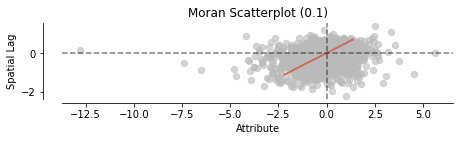

In [17]:
# This scatterplot shows how Moran's I is calculated (slope of the red line)

fig, ax = moran_scatterplot(moran_transit, aspect_equal=True)
plt.show()

Is this just caused by random variation?

/opt/conda/lib/python3.8/site-packages/splot/_viz_esda_mpl.py:47: MatplotlibDeprecationWarning: 
The set_smart_bounds function was deprecated in Matplotlib 3.2 and will be removed two minor releases later.
  ax.spines['left'].set_smart_bounds(True)
/opt/conda/lib/python3.8/site-packages/splot/_viz_esda_mpl.py:48: MatplotlibDeprecationWarning: 
The set_smart_bounds function was deprecated in Matplotlib 3.2 and will be removed two minor releases later.
  ax.spines['bottom'].set_smart_bounds(True)


(<Figure size 504x504 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7fd94eecc550>)

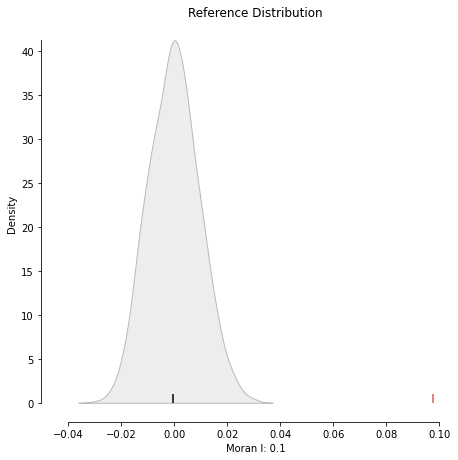

In [18]:
plot_moran_simulation(moran_transit,aspect_equal=False)

No, because Moran's I is outside of the gray curve, it is extremely likely that it is not random

In [19]:
# compute the p value
moran_transit.p_sim

0.001

In [20]:
# calculate local moran values
lisa_transit = esda.moran.Moran_Local(y_transit, wq)

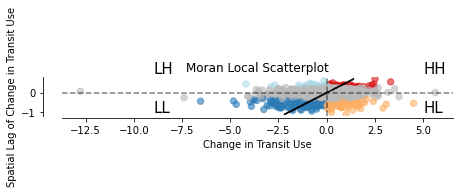

In [21]:
# Plot the aurocorreated clusters over p = 0.05
fig, ax = moran_scatterplot(lisa_transit, p=0.05)
ax.set_xlabel("Change in Transit Use")
ax.set_ylabel('Spatial Lag of Change in Transit Use')
plt.text(5, 1, "HH", fontsize=15)
plt.text(5, -1, "HL", fontsize=15)
plt.text(-9, 1, "LH", fontsize=15)
plt.text(-9, -1, "LL", fontsize=15)
plt.show()

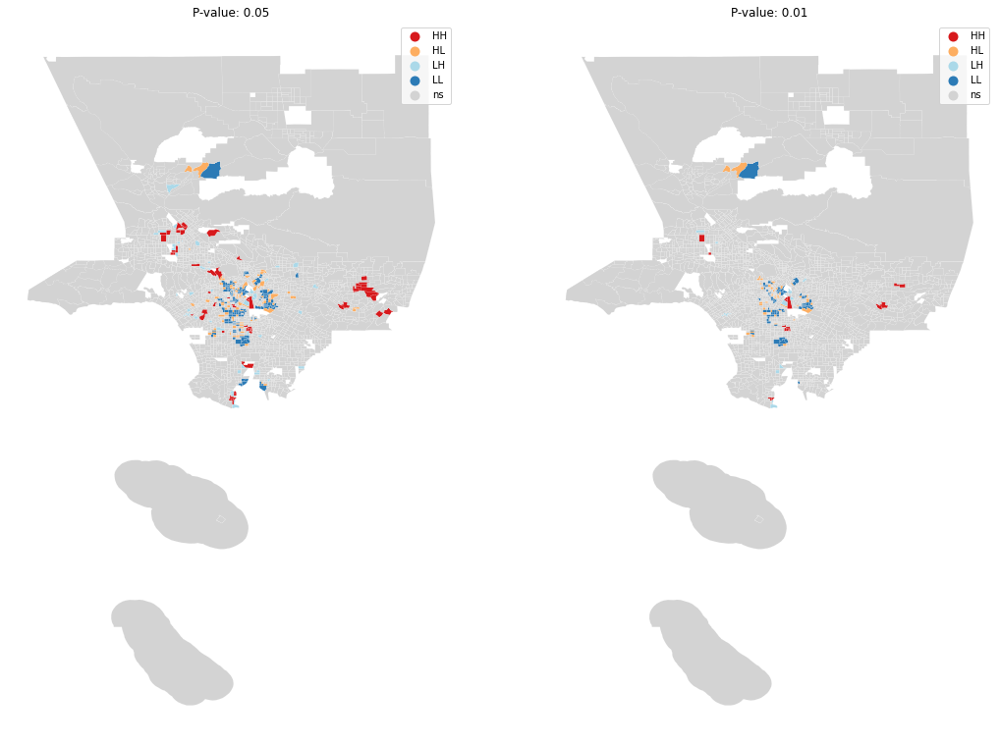

In [22]:
# create the 1x2 subplots
fig, axs = plt.subplots(1, 2, figsize=(18, 18))

# name each subplot
ax1, ax2 = axs

# regular count map on the left
lisa_cluster(lisa_transit, tracts_data, p=0.05, ax=ax1)

ax1.axis("off")
ax1.set_title("P-value: 0.05")

# spatial lag map on the right
lisa_cluster(lisa_transit, tracts_data, p=0.01, ax=ax2)
ax2.axis("off")
ax2.set_title("P-value: 0.01")

plt.show()

It looks like there are clusters of transit use _decrease_ in Central, South Central, and East LA. This initially seems surprising, since that is where there is the most transit, but as those areas have become more expensive it's likely that people who can afford to have cars have moved in

## Moran's Plot: Housing Units

Let's do this again for change in number of housing units

In [23]:
# find Moran's I for change in median rent
y_housing = tracts_data['Change Housing Units']
moran_housing = Moran(y_housing, wq)
moran_housing.I

0.09247776004400801

In [24]:
# compute the p value
moran_housing.p_sim

0.001

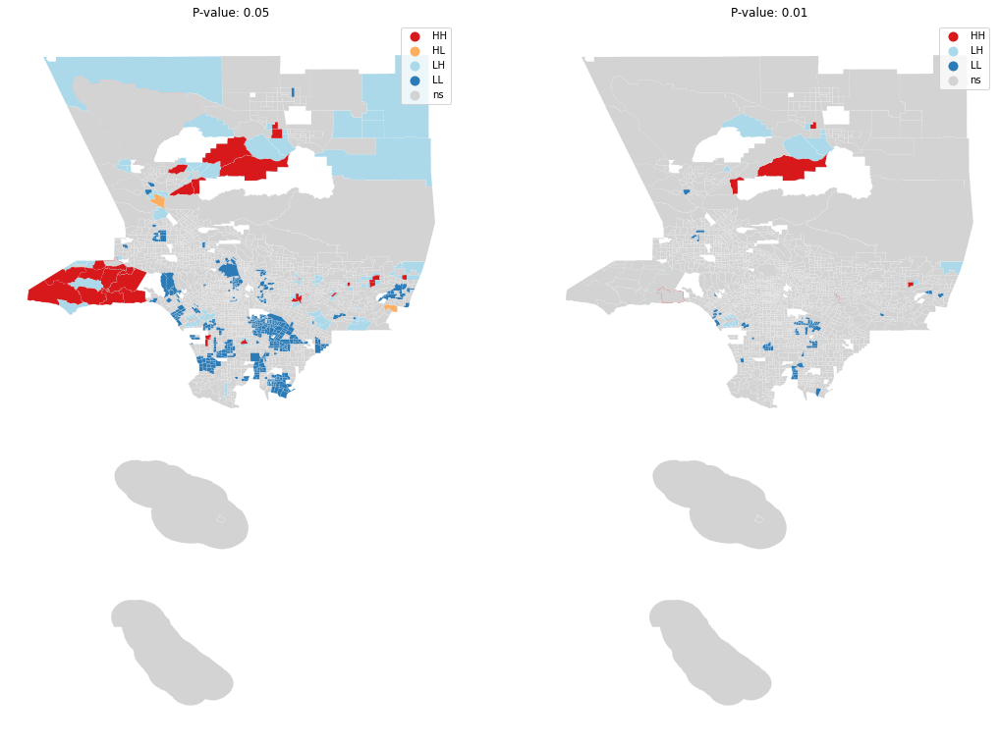

In [25]:
# calculate local moran values
lisa_housing = esda.moran.Moran_Local(y_housing, wq)

# create the 1x2 subplots
fig, axs = plt.subplots(1, 2, figsize=(18, 18))

# name each subplot
ax1, ax2 = axs

# regular count map on the left
lisa_cluster(lisa_housing, tracts_data, p=0.05, ax=ax1)

ax1.axis("off")
ax1.set_title("P-value: 0.05")

# spatial lag map on the right
lisa_cluster(lisa_housing, tracts_data, p=0.01, ax=ax2)
ax2.axis("off")
ax2.set_title("P-value: 0.01")

plt.show()

# Buffers

Now we are ready to figure out which census tracts are within a buffer around each station

In [26]:
# importing the index, stop number, and date opened for each station from a different csv file

station_opened = pd.read_csv('Data/station_data.csv', 
                             header = 1, 
                             index_col = 'Unnamed: 0',
                             usecols = ['Unnamed: 0', 'STOPNUM', 'DATE OPENED'])

In [27]:
# display a sample to check the data

station_opened.sample(5)

,STOPNUM,DATE OPENED
8,80111,1990
53,80306,1995
83,80133,2016
48,80301,1995
42,80211,1993


In [28]:
# import the station data shapefile from LA Metro

sta = gpd.read_file('Data/Stations_All_0316.shp')

In [29]:
# display the head to check the data

sta.head()

,LINE,LINENUM,LINENUM2,STNSEQ,STNSEQ2,DIR,STOPNUM,STATION,LAT,LONG,TPIS_NAME,POINT_X,POINT_Y,geometry
0,Blue,801,0,21,0,None,80101,Downtown Long Beach Station,33.768071,-118.192921,Long Bch,6.503030e+06,1.738034e+06,POINT (-118.19292 33.76807)
1,Blue,801,0,22,0,North,80102,Pacific Ave Station,33.772258,-118.193700,Pacific,6.502796e+06,1.739558e+06,POINT (-118.19370 33.77226)
2,Blue,801,0,18,0,None,80105,Anaheim Street Station,33.781830,-118.189384,Anaheim,6.504115e+06,1.743039e+06,POINT (-118.18938 33.78183)
3,Blue,801,0,17,0,None,80106,Pacific Coast Hwy Station,33.789090,-118.189382,PCH,6.504120e+06,1.745681e+06,POINT (-118.18938 33.78909)
4,Blue,801,0,16,0,None,80107,Willow Street Station,33.807079,-118.189834,Willow,6.503995e+06,1.752228e+06,POINT (-118.18983 33.80708)


In [30]:
# merge the two files together to make one file with both geometry for the station and the station opening date

station = sta.merge(station_opened,on="STOPNUM")

In [31]:
# run a random sample to make sure entire data set is still working 

station.sample(5)

,LINE,LINENUM,LINENUM2,STNSEQ,STNSEQ2,DIR,STOPNUM,STATION,LAT,LONG,TPIS_NAME,POINT_X,POINT_Y,geometry,DATE OPENED
19,Blue/EXPO,801,806,1,12,None,80122,7th St / Metro Center Station - Metro Blue & E...,34.048610,-118.258822,7MC,6.483263e+06,1.840173e+06,POINT (-118.25882 34.04861),1991
48,Green,803,0,14,0,None,80301,Redondo Beach Station,33.894640,-118.369196,Rdndo Bch,6.449622e+06,1.784245e+06,POINT (-118.36920 33.89464),1995
26,EXPO,806,0,9,0,None,80129,Farmdale Station,34.023981,-118.346095,Farmdale,6.456795e+06,1.831290e+06,POINT (-118.34610 34.02398),2012
65,Gold,804,0,24,0,None,80404,Indiana Station,34.034300,-118.192182,Indiana,6.503440e+06,1.834920e+06,POINT (-118.19218 34.03430),2009
30,Blue,801,0,20,0,South,80153,1st Street Station,33.768740,-118.189362,1st St,6.504112e+06,1.738275e+06,POINT (-118.18936 33.76874),1990


In [32]:
# convert to web mercator 

station = station.to_crs(epsg=3857)
tracts_data = tracts_data.to_crs(epsg=3857)

In [33]:
# create new column called buffer. Shoutout to Rayne for providing us with this line 

station['buffers'] = station.geometry.buffer(1200)

In [34]:
# display the head to check the data - looks good!

station.head()

,LINE,LINENUM,LINENUM2,STNSEQ,STNSEQ2,DIR,STOPNUM,STATION,LAT,LONG,TPIS_NAME,POINT_X,POINT_Y,geometry,DATE OPENED,buffers
0,Blue,801,0,21,0,None,80101,Downtown Long Beach Station,33.768071,-118.192921,Long Bch,6.503030e+06,1.738034e+06,POINT (-13157175.781 3997701.981),1990,"POLYGON ((-13155975.781 3997701.981, -13155981..."
1,Blue,801,0,22,0,North,80102,Pacific Ave Station,33.772258,-118.193700,Pacific,6.502796e+06,1.739558e+06,POINT (-13157262.499 3998262.680),1990,"POLYGON ((-13156062.499 3998262.680, -13156068..."
2,Blue,801,0,18,0,None,80105,Anaheim Street Station,33.781830,-118.189384,Anaheim,6.504115e+06,1.743039e+06,POINT (-13156782.044 3999544.611),1990,"POLYGON ((-13155582.044 3999544.611, -13155587..."
3,Blue,801,0,17,0,None,80106,Pacific Coast Hwy Station,33.789090,-118.189382,PCH,6.504120e+06,1.745681e+06,POINT (-13156781.821 4000517.002),1990,"POLYGON ((-13155581.821 4000517.002, -13155587..."
4,Blue,801,0,16,0,None,80107,Willow Street Station,33.807079,-118.189834,Willow,6.503995e+06,1.752228e+06,POINT (-13156832.138 4002926.773),1990,"POLYGON ((-13155632.138 4002926.773, -13155637..."


Let's see if we can get these buffers onto a blank map

In [35]:
# initialize a new map centered on LA
m_buffer = folium.Map(location=[34,-118.2], 
               zoom_start = 10,             
               tiles='CartoDB positron', 
               attribution='CartoDB')

# add the buffer polygons to the map
folium.GeoJson(data=station['buffers']).add_to(m_buffer)


# display map
m_buffer

Let's see if we can add these buffers to a map we already have, the one of change in transit use.

In [36]:
# make a copy of the folium map with change in transit

m_station = m

In [37]:
#add the buffers to the transit map

folium.GeoJson(data=station['buffers']).add_to(m_station)

m_station

# Trying polygon intersect

Now we want to find which census tracts intersect those buffers. We first test it out for one station using code from https://medium.com/nam-r/10-essential-operations-for-spatial-data-in-python-4603d933bdda

In [38]:
# assign the buffer for Mariachi Station to the variable G1

g1 = station.buffers[67]

In [39]:
# lets see how it looks

print(g1)

POLYGON ((-13158951.01712004 4035143.610382665, -13158956.79544804 4035025.989814269, -13158974.07478356 4034909.501996246, -13159002.68871716 4034795.268769959, -13159042.36168103 4034684.390263827, -13159092.71160283 4034577.934298474, -13159153.25358528 4034476.926103042, -13159223.40457601 4034382.338441669, -13159302.48898262 4034295.082245241, -13159389.74517905 4034215.99783863, -13159484.33284042 4034145.846847902, -13159585.34103585 4034085.304865447, -13159691.79700121 4034034.954943651, -13159802.67550734 4033995.281979786, -13159916.90873362 4033966.668046181, -13160033.39655165 4033949.388710659, -13160151.01712004 4033943.610382665, -13160268.63768844 4033949.388710659, -13160385.12550646 4033966.668046181, -13160499.35873275 4033995.281979786, -13160610.23723888 4034034.954943651, -13160716.69320423 4034085.304865447, -13160817.70139967 4034145.846847902, -13160912.28906104 4034215.99783863, -13160999.54525747 4034295.082245241, -13161078.62966408 4034382.338441669, -131

In [40]:
# Use method #5 at this site
# https://medium.com/nam-r/10-essential-operations-for-spatial-data-in-python-4603d933bdda
intersect_list = tracts_data['geometry'].apply(lambda g: g.intersects(g1))

# calculate the area of the intersections
areas = tracts_data.loc[intersect_list,'geometry'].apply(lambda g: g.intersection(g1).area)

In [41]:
# Display the area of intersection for the tracts that intersect
# We won't use the areas, but the list of tracts that intersect will come in handy

areas

513    1.102824e+06
514    3.168349e+05
521    3.918856e+01
522    1.018275e+03
523    4.330632e+05
524    4.123460e+05
525    2.958571e+05
535    6.638131e+04
536    1.426569e+06
537    4.647259e+05
Name: geometry, dtype: float64

In [42]:
# let's see what intersect_list looks like just to help us understand how this works
# looks like it just shows True/False for each tract if it intersects with the Mariachi Station buffer

intersect_list

0       False
1       False
2       False
3       False
4       False
        ...  
2460    False
2461    False
2462    False
2463    False
2464    False
Name: geometry, Length: 2465, dtype: bool

## Plot the Census Tracts that intersect with the Mariachi Station buffer

In [43]:
# find the row that hold Mariachi Station
station[station['STATION'].str.contains('Mariachi')]

,LINE,LINENUM,LINENUM2,STNSEQ,STNSEQ2,DIR,STOPNUM,STATION,LAT,LONG,TPIS_NAME,POINT_X,POINT_Y,geometry,DATE OPENED,buffers
67,Gold,804,0,22,0,None,80406,Mariachi Plaza / Boyle Heights Station,34.047215,-118.219648,Mariachi,6.495129e+06,1.839637e+06,POINT (-13160151.017 4035143.610),2009,"POLYGON ((-13158951.017 4035143.610, -13158956..."


In [44]:
# initilialize a blank map stationed on Mariachi Plaza station
m_mariachi = folium.Map(location=[34.047, -118.219], 
               zoom_start = 14,             
               tiles='CartoDB positron', 
               attribution='CartoDB')

# add Mariachi buffer to map
folium.GeoJson(data=station[station['STATION'].str.contains('Mariachi')].buffers).add_to(m_mariachi)

# show map
m_mariachi

In [45]:
# use area intercept data to make a list of census tracts surrounding Mariachi Plaza
# select those rows and all columns

mariachi_tracts = tracts_data.loc[[513, 514, 521, 522, 523, 524, 525, 535, 536, 537],:]
mariachi_tracts

,FIPS,geometry,Geo_NAME,Geo_QName,Geo_STATE,Geo_COUNTY,Geo_TRACT,2010 Housing Units,2010 Median Gross Rent,2010 Percent Transit,2018 Housing Units,2018 Median Gross Rent,2018 Percent Transit,Change Housing Units,Change Median Rent,Change Percent Transit,transit_lag,rent_lag,housing_lag
513,06037203500,"MULTIPOLYGON (((-13161130.740 4035935.902, -13...","Census Tract 2035, Los Angeles city (part), Lo...","Census Tract 2035, Los Angeles city (part), Lo...",06,037,203500,1077,864.0,15.70,1040,1082.0,13.64,-0.034355,0.252315,-2.06,2.29500,0.119733,0.203471
514,06037203600,"MULTIPOLYGON (((-13159515.828 4035495.479, -13...","Census Tract 2036, Los Angeles city (part), Lo...","Census Tract 2036, Los Angeles city (part), Lo...",06,037,203600,1474,929.0,16.84,1489,1158.0,14.98,0.010176,0.246502,-1.86,-3.47250,0.095787,-0.010584
521,06037204200,"MULTIPOLYGON (((-13159050.847 4034671.916, -13...","Census Tract 2042, Los Angeles city (part), Lo...","Census Tract 2042, Los Angeles city (part), Lo...",06,037,204200,975,924.0,26.35,1020,993.0,20.67,0.046154,0.074675,-5.68,-4.52750,0.145623,-0.006907
522,06037204300,"MULTIPOLYGON (((-13159272.595 4034256.396, -13...","Census Tract 2043, Los Angeles city (part), Lo...","Census Tract 2043, Los Angeles city (part), Lo...",06,037,204300,1347,986.0,12.30,1366,1069.0,18.01,0.014105,0.084178,5.71,-2.83375,0.098008,0.022836
523,06037204410,"MULTIPOLYGON (((-13160013.760 4034765.286, -13...","Census Tract 2044.10, Los Angeles city (part),...","Census Tract 2044.10, Los Angeles city (part),...",06,037,204410,640,931.0,9.98,667,1070.0,16.21,0.042188,0.149302,6.23,-1.67875,0.104115,0.040995
524,06037204420,"MULTIPOLYGON (((-13159685.034 4034478.730, -13...","Census Tract 2044.20, Los Angeles city (part),...","Census Tract 2044.20, Los Angeles city (part),...",06,037,204420,957,948.0,27.13,1007,1000.0,28.68,0.052247,0.054852,1.55,-2.47250,0.093149,0.041872
525,06037204600,"MULTIPOLYGON (((-13160234.952 4032801.051, -13...","Census Tract 2046, Los Angeles city (part), Lo...","Census Tract 2046, Los Angeles city (part), Lo...",06,037,204600,1127,1031.0,22.36,1212,973.0,20.31,0.075421,-0.056256,-2.05,-0.91000,0.089232,0.057508
535,06037206031,"MULTIPOLYGON (((-13162384.309 4030788.941, -13...","Census Tract 2060.31, Los Angeles city (part),...","Census Tract 2060.31, Los Angeles city (part),...",06,037,206031,1300,1916.0,9.58,2643,2366.0,13.17,1.033077,0.234864,3.59,2.93250,0.081942,0.247501
536,06037206032,"MULTIPOLYGON (((-13161302.061 4035236.716, -13...","Census Tract 2060.32, Los Angeles city (part),...","Census Tract 2060.32, Los Angeles city (part),...",06,037,206032,1470,940.0,14.39,1780,1051.0,12.54,0.210884,0.118085,-1.85,5.08750,0.129236,0.269152
537,06037206050,"MULTIPOLYGON (((-13160499.892 4030849.912, -13...","Census Tract 2060.50, Los Angeles city (part),...","Census Tract 2060.50, Los Angeles city (part),...",06,037,206050,746,804.0,18.06,848,825.0,17.69,0.136729,0.026119,-0.37,-2.14000,0.107625,0.166680


In [46]:
# initilialize a blank map stationed on Mariachi Plaza station
m_mariachi_tracts = folium.Map(location=[34.047, -118.219], 
               zoom_start = 14,             
               tiles='CartoDB positron', 
               attribution='CartoDB')


# plot chorpleth map of change in transit use JUST for the tracts that intersect the buffer of Mariachi Plaza
folium.Choropleth(
                  geo_data=mariachi_tracts,                       # geo data
                  data=mariachi_tracts,                           # data          
                  key_on='feature.properties.FIPS',           # key, or merge column
                  columns=['FIPS', 'Change Percent Transit'], # [key, value]
                  fill_color='RdYlBu',                        # using a diverging scale from colorbrewer2.org
                  line_weight=0.1, 
                  fill_opacity=0.6,
                  line_opacity=0.2,                           # line opacity (of the border)
                  legend_name='Change in Transit Use',
                  threshold_scale=[-67, -10, -1, 1, 10, 41],  # change thresholds
                  nan_fill_color = 'lightgray').add_to(m_mariachi_tracts) 

# add Mariachi buffer to map
folium.GeoJson(data=station[station['STATION'].str.contains('Mariachi')].buffers).add_to(m_mariachi_tracts)

# show map
m_mariachi_tracts

## Loop through the stations and census tracts

In [47]:
# create a sorted list of unique years t

years = station['DATE OPENED'].unique().tolist()
years = np.sort(years)
years

array([1990, 1991, 1993, 1995, 1996, 1999, 2000, 2003, 2009, 2012, 2016])

In [48]:
# subset the data: stations that opened before 2010, in 2012, and in 2016

station10 = station[station['DATE OPENED'] <= 2010]
station12 = station[station['DATE OPENED'] == 2012]
station16 = station[station['DATE OPENED'] == 2016]

In [49]:
# explore data to check if stations that opened in 2010 under Date Opened works 

station10.sample(2)

,LINE,LINENUM,LINENUM2,STNSEQ,STNSEQ2,DIR,STOPNUM,STATION,LAT,LONG,TPIS_NAME,POINT_X,POINT_Y,geometry,DATE OPENED,buffers
63,Gold,804,0,26,0,None,80402,East LA Civic Center Station,34.033364,-118.161206,ELACC,6.512824e+06,1.834563e+06,POINT (-13153645.283 4033282.876),2009,"POLYGON ((-13152445.283 4033282.876, -13152451..."
48,Green,803,0,14,0,None,80301,Redondo Beach Station,33.894640,-118.369196,Rdndo Bch,6.449622e+06,1.784245e+06,POINT (-13176798.624 4014663.511),1995,"POLYGON ((-13175598.624 4014663.511, -13175604..."


In [50]:
# now let's do it for stations opened in 2012 

station12.sample(2)

,LINE,LINENUM,LINENUM2,STNSEQ,STNSEQ2,DIR,STOPNUM,STATION,LAT,LONG,TPIS_NAME,POINT_X,POINT_Y,geometry,DATE OPENED,buffers
26,EXPO,806,0,9,0,None,80129,Farmdale Station,34.023981,-118.346095,Farmdale,6.456795e+06,1.831290e+06,POINT (-13174227.033 4032022.543),2012,"POLYGON ((-13173027.033 4032022.543, -13173032..."
27,EXPO,806,0,10,0,None,80130,Expo / La Brea Station,34.024803,-118.355159,Ex/LBrea,6.454050e+06,1.831599e+06,POINT (-13175236.033 4032132.949),2012,"POLYGON ((-13174036.033 4032132.949, -13174041..."


In [51]:
# and now lets do it one more time to check for stations that opened in 2016 

station16.sample(2)

,LINE,LINENUM,LINENUM2,STNSEQ,STNSEQ2,DIR,STOPNUM,STATION,LAT,LONG,TPIS_NAME,POINT_X,POINT_Y,geometry,DATE OPENED,buffers
86,EXPO,806,0,16,0,None,80136,Expo / Bundy Station,34.031705,-118.452896,Bundy,6424446.0,1834230.0,POINT (-13186116.066 4033060.028),2016,"POLYGON ((-13184916.066 4033060.028, -13184921..."
95,Gold,804,0,1,0,None,80427,APU / Citrus College Station,34.136814,-117.891636,APU/Cit,6594458.0,1872189.0,POINT (-13123636.888 4047187.631),2016,"POLYGON ((-13122436.888 4047187.631, -13122442..."


In [52]:
# Add three columns to the tracts data to say if there are stations that opened before 2010, in 2012, or in 2016. 
# Set the default value to false. 
# In the loop we will change them to true if a station opened.

tracts_data['Station10'] = False
tracts_data['Station12'] = False
tracts_data['Station16'] = False

In [53]:
# take a look at the new columns

tracts_data.sample(2)

,FIPS,geometry,Geo_NAME,Geo_QName,Geo_STATE,Geo_COUNTY,Geo_TRACT,2010 Housing Units,2010 Median Gross Rent,2010 Percent Transit,...,2018 Percent Transit,Change Housing Units,Change Median Rent,Change Percent Transit,transit_lag,rent_lag,housing_lag,Station10,Station12,Station16
1,06037101122,"MULTIPOLYGON (((-13169466.900 4065590.632, -13...","Census Tract 1011.22, Los Angeles city (part),...","Census Tract 1011.22, Los Angeles city (part),...",06,037,101122,1393,1581.0,1.92,...,0.37,-0.001436,0.340923,-1.55,0.79375,0.190392,0.018180,False,False,False
1712,06037535503,"MULTIPOLYGON (((-13159884.073 4022430.952, -13...","Census Tract 5355.03, South Gate city, South G...","Census Tract 5355.03, South Gate city, South G...",06,037,535503,624,976.0,13.51,...,12.85,0.008013,0.080943,-0.66,-2.27750,0.017743,-0.010989,False,False,False


## The loop!

With help from https://stackoverflow.com/questions/23330654/update-a-dataframe-in-pandas-while-iterating-row-by-row

In [54]:
# iterates through each of the stations 
for index_s, row_s in station12.iterrows():
    
    geom = row_s.buffers                     #Takes buffer from each line and assigns it to variable geom
    
    for index_t, row_t in tracts_data.iterrows():   # iterate through tracts data 
        
        if row_t.geometry.intersects(geom) == True:     # if geometry intercepts geom...
            
            # print(row_s.STATION + " " + row_t.Geo_TRACT) # this line was just used for testing if it was working
            
            tracts_data.at[index_t, 'Station12'] = True    #... then set the value to True

In [55]:
# take a look at rows that intersect buffers from stations opened in 2012

tracts_data[tracts_data.Station12 == True]

,FIPS,geometry,Geo_NAME,Geo_QName,Geo_STATE,Geo_COUNTY,Geo_TRACT,2010 Housing Units,2010 Median Gross Rent,2010 Percent Transit,...,2018 Percent Transit,Change Housing Units,Change Median Rent,Change Percent Transit,transit_lag,rent_lag,housing_lag,Station10,Station12,Station16
658,06037218702,"MULTIPOLYGON (((-13173722.867 4033195.698, -13...","Census Tract 2187.02, Los Angeles city (part),...","Census Tract 2187.02, Los Angeles city (part),...",06,037,218702,844,974.0,23.63,...,10.70,0.024882,0.054415,-12.93,-2.50750,0.102530,0.042114,False,True,False
660,06037218900,"MULTIPOLYGON (((-13172433.119 4032874.123, -13...","Census Tract 2189, Los Angeles city (part), Lo...","Census Tract 2189, Los Angeles city (part), Lo...",06,037,218900,2206,1036.0,12.06,...,15.61,0.005893,0.166988,3.55,-5.88000,0.131716,0.041554,False,True,False
661,06037219010,"MULTIPOLYGON (((-13172238.867 4032514.813, -13...","Census Tract 2190.10, Los Angeles city (part),...","Census Tract 2190.10, Los Angeles city (part),...",06,037,219010,864,1005.0,7.91,...,9.49,0.078704,0.323383,1.58,-5.86000,0.120218,0.023863,False,True,False
662,06037219020,"MULTIPOLYGON (((-13172250.110 4031882.992, -13...","Census Tract 2190.20, Los Angeles city (part),...","Census Tract 2190.20, Los Angeles city (part),...",06,037,219020,1487,1079.0,15.52,...,10.04,0.032280,-0.006487,-5.48,-3.23750,0.194038,0.028448,False,True,False
663,06037219300,"MULTIPOLYGON (((-13173002.964 4032029.930, -13...","Census Tract 2193, Los Angeles city (part), Lo...","Census Tract 2193, Los Angeles city (part), Lo...",06,037,219300,1473,1118.0,21.69,...,16.07,0.038697,-0.021467,-5.62,-4.99000,0.148176,0.028221,False,True,False
664,06037219500,"MULTIPOLYGON (((-13174125.398 4031527.877, -13...","Census Tract 2195, Los Angeles city (part), Lo...","Census Tract 2195, Los Angeles city (part), Lo...",06,037,219500,802,1117.0,10.66,...,6.96,0.001247,0.078782,-3.70,-1.83625,0.073489,0.066971,False,True,False
665,06037219700,"MULTIPOLYGON (((-13175288.798 4031837.192, -13...","Census Tract 2197, Los Angeles city (part), Lo...","Census Tract 2197, Los Angeles city (part), Lo...",06,037,219700,1369,1096.0,7.50,...,7.78,0.075237,0.024635,0.28,1.87875,0.033932,0.039238,False,True,False
666,06037219800,"MULTIPOLYGON (((-13175604.500 4032443.087, -13...","Census Tract 2198, Los Angeles city (part), Lo...","Census Tract 2198, Los Angeles city (part), Lo...",06,037,219800,1118,1064.0,19.17,...,16.73,-0.033989,0.121241,-2.44,-3.45875,0.350323,0.029278,False,True,False
667,06037219901,"MULTIPOLYGON (((-13176268.187 4032549.602, -13...","Census Tract 2199.01, Los Angeles city (part),...","Census Tract 2199.01, Los Angeles city (part),...",06,037,219901,1520,1118.0,9.52,...,13.16,0.030263,-0.029517,3.64,-3.58750,0.374685,0.025483,False,True,False
668,06037219902,"MULTIPOLYGON (((-13177668.697 4032390.031, -13...","Census Tract 2199.02, Los Angeles city (part),...","Census Tract 2199.02, Los Angeles city (part),...",06,037,219902,1259,1151.0,22.30,...,5.48,-0.003971,0.165074,-16.82,-1.92125,0.386685,0.011266,False,True,False


In [56]:
#repeat the process for stations opened pre-2010

for index_s, row_s in station10.iterrows():
    
    geom = row_s.buffers
    
    for index_t, row_t in tracts_data.iterrows():
        
        if row_t.geometry.intersects(geom) == True:           
           
            tracts_data.at[index_t, 'Station10'] = True

In [57]:
# look at a sample again

tracts_data[tracts_data.Station10 == True].sample(10)

,FIPS,geometry,Geo_NAME,Geo_QName,Geo_STATE,Geo_COUNTY,Geo_TRACT,2010 Housing Units,2010 Median Gross Rent,2010 Percent Transit,...,2018 Percent Transit,Change Housing Units,Change Median Rent,Change Percent Transit,transit_lag,rent_lag,housing_lag,Station10,Station12,Station16
582,06037211201,"MULTIPOLYGON (((-13169139.621 4038642.629, -13...","Census Tract 2112.01, Los Angeles city (part),...","Census Tract 2112.01, Los Angeles city (part),...",06,037,211201,995,1207.0,35.60,...,29.21,-0.019095,0.038940,-6.39,-4.69875,0.124465,-0.000504,True,False,False
585,06037211320,"MULTIPOLYGON (((-13168724.288 4038321.438, -13...","Census Tract 2113.20, Los Angeles city (part),...","Census Tract 2113.20, Los Angeles city (part),...",06,037,211320,1369,853.0,39.48,...,29.69,0.000000,0.257913,-9.79,-4.75000,0.109420,-0.001474,True,False,False
485,06037197600,"MULTIPOLYGON (((-13164222.861 4037915.863, -13...","Census Tract 1976, Los Angeles city (part), Lo...","Census Tract 1976, Los Angeles city (part), Lo...",06,037,197600,919,1036.0,14.04,...,10.26,0.089227,0.396718,-3.78,-9.55000,0.205375,0.106457,True,False,False
407,06037189600,"MULTIPOLYGON (((-13173147.679 4042997.615, -13...","Census Tract 1896, Los Angeles city (part), Lo...","Census Tract 1896, Los Angeles city (part), Lo...",06,037,189600,2304,1266.0,1.57,...,8.73,-0.012153,0.280411,7.16,-6.02625,0.165656,0.196165,True,False,False
1944,06037572100,"MULTIPOLYGON (((-13158568.054 4004524.501, -13...","Census Tract 5721, Long Beach city, Long Beach...","Census Tract 5721, Long Beach city, Long Beach...",06,037,572100,342,1380.0,0.00,...,4.68,-0.052632,-0.081159,4.68,1.33625,NaN,-0.015117,True,False,False
1425,06037462302,"MULTIPOLYGON (((-13150433.827 4048464.172, -13...","Census Tract 4623.02, Pasadena city, Pasadena ...","Census Tract 4623.02, Pasadena city, Pasadena ...",06,037,462302,1473,1612.0,6.77,...,4.71,0.122200,0.082506,-2.06,-1.06500,0.080663,0.044229,True,False,False
418,06037190202,"MULTIPOLYGON (((-13173403.491 4042506.909, -13...","Census Tract 1902.02, Los Angeles city (part),...","Census Tract 1902.02, Los Angeles city (part),...",06,037,190202,2223,1156.0,20.75,...,11.51,0.183086,0.356401,-9.24,0.37125,0.164234,0.019812,True,False,False
1423,06037462202,"MULTIPOLYGON (((-13151446.612 4048589.803, -13...","Census Tract 4622.02, Pasadena city, Pasadena ...","Census Tract 4622.02, Pasadena city, Pasadena ...",06,037,462202,1639,2034.0,9.17,...,9.10,0.126297,0.091937,-0.07,-0.90125,0.039579,0.080099,True,False,False
1960,06037573202,"MULTIPOLYGON (((-13156780.374 4000742.432, -13...","Census Tract 5732.02, Long Beach city, Long Be...","Census Tract 5732.02, Long Beach city, Long Be...",06,037,573202,1641,1021.0,3.44,...,11.55,0.070689,0.164545,8.11,-0.44375,0.010671,-0.004834,True,False,False
2058,06037601600,"MULTIPOLYGON (((-13176891.020 4019555.663, -13...","Census Tract 6016 (part), Lennox CDP, Inglewoo...","Census Tract 6016 (part), Lennox CDP, Inglewoo...",06,037,601600,1049,1100.0,10.15,...,12.76,0.034318,-0.025455,2.61,-8.25125,0.091841,1.089972,True,False,False


In [58]:
# for the last time with the stations that opened in 2016

for index_s, row_s in station16.iterrows():
    
    geom = row_s.buffers
    
    for index_t, row_t in tracts_data.iterrows():
        
        if row_t.geometry.intersects(geom) == True:
                        
            tracts_data.at[index_t, 'Station16'] = True

In [59]:
# now let's look at a sample of all the data to see if the new columns look okay

tracts_data.sample(20)

,FIPS,geometry,Geo_NAME,Geo_QName,Geo_STATE,Geo_COUNTY,Geo_TRACT,2010 Housing Units,2010 Median Gross Rent,2010 Percent Transit,...,2018 Percent Transit,Change Housing Units,Change Median Rent,Change Percent Transit,transit_lag,rent_lag,housing_lag,Station10,Station12,Station16
2338,06037910207,"MULTIPOLYGON (((-13156761.005 4108272.819, -13...","Census Tract 9102.07, Palmdale city (part), So...","Census Tract 9102.07, Palmdale city (part), So...",06,037,910207,1690,2310.0,4.15,...,4.05,0.059172,-0.208658,-0.10,-1.82000,NaN,3.540448,False,False,False
816,06037241300,"MULTIPOLYGON (((-13168149.879 4018743.580, -13...","Census Tract 2413, Los Angeles city (part), Lo...","Census Tract 2413, Los Angeles city (part), Lo...",06,037,241300,720,1058.0,7.10,...,12.36,0.063889,-0.118147,5.26,-5.54875,0.002882,0.044411,True,False,False
399,06037188300,"MULTIPOLYGON (((-13165764.080 4045204.308, -13...","Census Tract 1883, Los Angeles city (part), Lo...","Census Tract 1883, Los Angeles city (part), Lo...",06,037,188300,1504,1206.0,2.63,...,3.48,0.016622,0.317579,0.85,-2.65000,0.155256,0.033733,False,False,False
2099,06037603200,"MULTIPOLYGON (((-13170113.889 4010781.835, -13...","Census Tract 6032, Gardena city, Inglewood CCD...","Census Tract 6032, Gardena city, Inglewood CCD...",06,037,603200,1189,1265.0,1.11,...,4.20,0.025231,0.001581,3.09,-0.57500,0.065165,0.001495,False,False,False
286,06037134424,"MULTIPOLYGON (((-13210039.070 4056625.129, -13...","Census Tract 1344.24 (part), Los Angeles city ...","Census Tract 1344.24 (part), Los Angeles city ...",06,037,134424,975,NaN,3.35,...,2.30,-0.004103,NaN,-1.05,1.07000,0.327034,0.935108,False,False,False
333,06037141102,"MULTIPOLYGON (((-13184200.703 4048311.103, -13...","Census Tract 1411.02, Los Angeles city (part),...","Census Tract 1411.02, Los Angeles city (part),...",06,037,141102,1433,1702.0,4.18,...,2.54,0.027913,0.133373,-1.64,1.45625,0.188016,0.033595,False,False,False
518,06037203900,"MULTIPOLYGON (((-13157851.602 4032947.195, -13...","Census Tract 2039, Los Angeles city (part), Lo...","Census Tract 2039, Los Angeles city (part), Lo...",06,037,203900,771,1129.0,8.37,...,10.38,-0.031128,-0.004429,2.01,-4.96000,0.074264,0.051630,True,False,False
35,06037104810,"MULTIPOLYGON (((-13182384.970 4062721.923, -13...","Census Tract 1048.10, Los Angeles city (part),...","Census Tract 1048.10, Los Angeles city (part),...",06,037,104810,1000,1430.0,4.55,...,5.58,0.095000,0.188811,1.03,-0.23750,0.038308,0.068345,False,False,False
2186,06037670403,"MULTIPOLYGON (((-13177837.792 3998732.874, -13...","Census Tract 6704.03 (part), Rancho Palos Verd...","Census Tract 6704.03 (part), Rancho Palos Verd...",06,037,670403,862,2310.0,0.97,...,1.08,0.211137,0.190476,0.11,0.42750,NaN,0.349415,False,False,False
2372,06037910804,"MULTIPOLYGON (((-13164172.656 4101179.306, -13...","Census Tract 9108.04 (part), Acton CDP, South ...","Census Tract 9108.04 (part), Acton CDP, South ...",06,037,910804,1016,2310.0,0.00,...,0.00,0.145669,-0.368831,0.00,0.43000,NaN,4.908299,False,False,False


In [60]:
# creating a new column with default value "no rail transit"

tracts_data['Transit'] = 'No rail transit'

In [61]:
# change the values in this new column, based on when a station opened in the previous three columns

for index, row in tracts_data.iterrows():
    if row.Station10 == True:
        tracts_data.at[index, 'Transit'] = 'Pre-2010'
    elif row.Station12 == True:
        tracts_data.at[index, 'Transit'] = 'Opened 2012'
    elif row.Station16 == True:
        tracts_data.at[index, 'Transit'] = 'Opened 2016'

In [62]:
# take a look at the new column

tracts_data.sample(20)

,FIPS,geometry,Geo_NAME,Geo_QName,Geo_STATE,Geo_COUNTY,Geo_TRACT,2010 Housing Units,2010 Median Gross Rent,2010 Percent Transit,...,Change Housing Units,Change Median Rent,Change Percent Transit,transit_lag,rent_lag,housing_lag,Station10,Station12,Station16,Transit
1034,06037302506,"MULTIPOLYGON (((-13163915.954 4045482.393, -13...","Census Tract 3025.06, Glendale city (part), Sa...","Census Tract 3025.06, Glendale city (part), Sa...",06,037,302506,1406,1416.0,8.07,...,-0.014936,0.020480,-4.10,-4.69375,0.082732,0.055074,False,False,False,No rail transit
643,06037216800,"MULTIPOLYGON (((-13177574.410 4036200.728, -13...","Census Tract 2168, Los Angeles city (part), Lo...","Census Tract 2168, Los Angeles city (part), Lo...",06,037,216800,1631,2091.0,6.48,...,-0.019007,-0.120995,3.39,0.58375,0.134836,0.054014,False,False,False,No rail transit
262,06037132002,"MULTIPOLYGON (((-13193428.309 4055605.142, -13...","Census Tract 1320.02, Los Angeles city (part),...","Census Tract 1320.02, Los Angeles city (part),...",06,037,132002,1090,1475.0,1.10,...,0.052294,0.357288,-0.70,0.25125,0.046253,0.025318,False,False,False,No rail transit
157,06037121210,"MULTIPOLYGON (((-13182008.265 4060921.572, -13...","Census Tract 1212.10, Los Angeles city (part),...","Census Tract 1212.10, Los Angeles city (part),...",06,037,121210,720,1085.0,1.36,...,0.136111,0.097696,4.29,1.26000,0.040275,0.055503,False,False,False,No rail transit
1450,06037480012,"MULTIPOLYGON (((-13144721.579 4044281.215, -13...","Census Tract 4800.12 (part), East San Gabriel ...","Census Tract 4800.12 (part), East San Gabriel ...",06,037,480012,1472,1315.0,9.92,...,0.173234,0.081369,-5.44,-2.15000,-0.005472,1.330485,False,False,False,No rail transit
570,06037209401,"MULTIPOLYGON (((-13167339.696 4036436.133, -13...","Census Tract 2094.01, Los Angeles city (part),...","Census Tract 2094.01, Los Angeles city (part),...",06,037,209401,1433,858.0,49.08,...,0.141661,0.025641,-14.10,0.98500,0.091061,0.038109,True,False,False,Pre-2010
1470,06037480901,"MULTIPOLYGON (((-13151841.240 4039676.282, -13...","Census Tract 4809.01, Alhambra city, Southwest...","Census Tract 4809.01, Alhambra city, Southwest...",06,037,480901,1676,1248.0,4.76,...,0.031623,0.098558,-0.25,-1.92500,0.035168,0.036111,False,False,False,No rail transit
1062,06037400204,"MULTIPOLYGON (((-13110861.864 4045254.196, -13...","Census Tract 4002.04 (part), La Verne city (pa...","Census Tract 4002.04 (part), La Verne city (pa...",06,037,400204,2014,1804.0,1.87,...,0.069017,NaN,0.74,0.44000,NaN,3.237723,False,False,False,No rail transit
1334,06037431002,"MULTIPOLYGON (((-13134672.880 4047698.446, -13...","Census Tract 4310.02, Monrovia city (part), Up...","Census Tract 4310.02, Monrovia city (part), Up...",06,037,431002,1388,1245.0,1.05,...,-0.056196,-0.065060,2.25,-0.55125,NaN,0.089080,False,False,False,No rail transit
1600,06037530005,"MULTIPOLYGON (((-13149502.640 4032420.252, -13...","Census Tract 5300.05, Montebello city (part), ...","Census Tract 5300.05, Montebello city (part), ...",06,037,530005,1516,1537.0,1.64,...,0.002639,NaN,0.41,-0.09875,0.054130,0.069503,False,False,False,No rail transit


In [63]:
# subset data for only the rows that DO NOT have 'no rail transit' to get all census tracts that are within station buffers

transit_tracts = tracts_data[tracts_data['Transit'] != 'No rail transit']

In [64]:
# look at a sample

transit_tracts.sample(3)

,FIPS,geometry,Geo_NAME,Geo_QName,Geo_STATE,Geo_COUNTY,Geo_TRACT,2010 Housing Units,2010 Median Gross Rent,2010 Percent Transit,...,Change Housing Units,Change Median Rent,Change Percent Transit,transit_lag,rent_lag,housing_lag,Station10,Station12,Station16,Transit
1833,06037552001,"MULTIPOLYGON (((-13146757.279 4016349.927, -13...","Census Tract 5520.01, Norwalk city, Downey-Nor...","Census Tract 5520.01, Norwalk city, Downey-Nor...",06,037,552001,1070,1645.0,1.24,...,-0.017757,0.085106,0.83,-0.43125,0.180542,-0.009098,True,False,False,Pre-2010
688,06037222002,"MULTIPOLYGON (((-13171080.365 4031317.151, -13...","Census Tract 2220.02, Los Angeles city (part),...","Census Tract 2220.02, Los Angeles city (part),...",06,037,222002,1409,1101.0,24.06,...,-0.034776,0.044505,-7.11,-3.63750,0.197500,0.054594,False,True,False,Opened 2012
1180,06037404202,"MULTIPOLYGON (((-13123470.911 4045127.930, -13...","Census Tract 4042.02 (part), Azusa city (part)...","Census Tract 4042.02 (part), Azusa city (part)...",06,037,404202,387,1241.0,3.73,...,1.103359,-0.016116,-0.69,-0.05250,0.045974,1.107485,False,False,True,Opened 2016


Now we can make a map with only those tracts that intersect with a station buffer!

In [65]:
# initialize a new map centerd on LA
m_transit_tracts = folium.Map(location=[34, -118.3], 
               zoom_start = 10,             
               tiles='CartoDB positron', 
               attribution='CartoDB')


# plot chorpleth map of change in transit use JUST for the tracts that intersect the buffer of Mariachi Plaza
folium.Choropleth(
                  geo_data=transit_tracts,                       # geo data
                  data=transit_tracts,                           # data          
                  key_on='feature.properties.FIPS',           # key, or merge column
                  columns=['FIPS', 'Change Percent Transit'], # [key, value]
                  fill_color='RdYlBu',                        # using a diverging scale from colorbrewer2.org
                  line_weight=0.1, 
                  fill_opacity=0.6,
                  line_opacity=0.2,                           # line opacity (of the border)
                  legend_name='Change in Transit Use',
                  threshold_scale=[-67, -10, -1, 1, 10, 41],  # change thresholds
                  nan_fill_color = 'lightgray').add_to(m_transit_tracts) 

# add buffers to map
folium.GeoJson(data=station.buffers).add_to(m_transit_tracts)

# show map
m_transit_tracts

# Doing analysis with plotly

Now that we have the column that divides every census tract by whether it is close to transit and when that transit opened, we can do additional analysis about how these different groups of tracts compare.

As a first step, let's take the the scatterplot we made at the beginning and colorcode it by proximity to transit


In [66]:
# import plotly express
import plotly.express as px

#create the plot
fig = px.scatter(tracts_data,
                 x = 'Change Median Rent',
                 y = 'Change Percent Transit',
                 color= "Transit",
                 title = 'Change in Median Rent vs Workers Using Transit, Colored by Opening of Rail Station')

# limit the y-axis boundaries
fig.update_yaxes(range=[-40, 30])

#show the plot
fig.show()

It's hard to look at this one, so let's split it into four different facets

In [67]:
#create the plot with facet columns
fig1 = px.scatter(tracts_data,
                 x = 'Change Median Rent',
                 y = 'Change Percent Transit',
                 color= "Transit",
                 title = 'Change in Median Rent vs Workers Using Transit, Colored by Opening of Rail Station',
                 facet_col="Transit")

# limit the y-axis boundaries
fig1.update_yaxes(range=[-40, 30])

#show the plot
fig1.show()

These are still difficult to compare, since they are all clustered generally in the same area, so we think boxplots will be more effective.

In [68]:
# create a box plot for change in rent in the diffetent categories
# with help from https://plotly.com/python/box-plots/

rent_box = px.box(tracts_data, 
                      x="Transit", 
                      y='Change Median Rent',
                      color= "Transit",
                      points="all"
                 )

# adjust the y-axis with help from https://plotly.com/python/axes/
rent_box.update_yaxes(range=[-0.5, 0.5])

# show boxplot
rent_box.show()

In [69]:
# create a similar box plot for change in transit

transit_box = px.box(tracts_data, 
                      x="Transit", 
                      y='Change Percent Transit',
                      color= "Transit",
                      points="all"
                    )

transit_box.update_yaxes(range=[-20, 20])

transit_box.show()

## Finding comparison tracts

It's hard to really compare census tracts near transit with those far away from transit without controling for lots of other variables like income and demographics. To approximate this, let's make another category of tracts that are within 1.5 miles of a station but not within the 0.75 mile buffer we already have. 

In [70]:
# add a 2400-meter (=0.75 mile) buffer around stations

station['buffers_2400'] = station.geometry.buffer(2400)

In [71]:
# make a copy of tracts_data
tracts_data_2400 = tracts_data[:]

In [72]:
# loop through the 2400m buffers for each station and each census tract in the "No rail transit" category
# see if they intersect and update the dataframe accordingly

for index_s, row_s in station.iterrows():
    
    geom = row_s.buffers_2400
    
    for index_t, row_t in tracts_data_2400.iterrows():
        
        if row_t['Transit'] == 'No rail transit':
            if row_t.geometry.intersects(geom) == True:
                tracts_data_2400.at[index_t, 'Transit'] = "Close no transit"

In [73]:
# show a sample of the data to check it
tracts_data_2400.sample(8)

,FIPS,geometry,Geo_NAME,Geo_QName,Geo_STATE,Geo_COUNTY,Geo_TRACT,2010 Housing Units,2010 Median Gross Rent,2010 Percent Transit,...,Change Housing Units,Change Median Rent,Change Percent Transit,transit_lag,rent_lag,housing_lag,Station10,Station12,Station16,Transit
1273,06037408134,"MULTIPOLYGON (((-13125062.557 4031605.642, -13...","Census Tract 4081.34, West Covina city, East S...","Census Tract 4081.34, West Covina city, East S...",06,037,408134,851,1599.0,4.00,...,-0.038778,0.203877,-3.23,-3.11875,0.130065,1.788483,False,False,False,No rail transit
668,06037219902,"MULTIPOLYGON (((-13177668.697 4032390.031, -13...","Census Tract 2199.02, Los Angeles city (part),...","Census Tract 2199.02, Los Angeles city (part),...",06,037,219902,1259,1151.0,22.30,...,-0.003971,0.165074,-16.82,-1.92125,0.386685,0.011266,False,True,False,Opened 2012
995,06037300502,"MULTIPOLYGON (((-13161885.263 4056999.873, -13...","Census Tract 3005.02 (part), La Cañada Flintri...","Census Tract 3005.02 (part), La Cañada Flintri...",06,037,300502,390,1709.0,6.34,...,5.687179,-0.086015,-4.24,0.51250,0.253597,0.304414,False,False,False,No rail transit
615,06037212800,"MULTIPOLYGON (((-13173110.387 4035654.422, -13...","Census Tract 2128, Los Angeles city (part), Lo...","Census Tract 2128, Los Angeles city (part), Lo...",06,037,212800,1435,1334.0,12.29,...,0.066899,-0.144678,-3.18,-4.05625,0.105357,0.009363,False,False,False,Close no transit
24,06037104310,"MULTIPOLYGON (((-13184692.735 4064746.296, -13...","Census Tract 1043.10, Los Angeles city (part),...","Census Tract 1043.10, Los Angeles city (part),...",06,037,104310,923,1767.0,1.94,...,-0.028169,0.295982,0.52,0.71625,0.242337,0.059449,False,False,False,No rail transit
2314,06037901009,"MULTIPOLYGON (((-13156137.727 4119864.721, -13...","Census Tract 9010.09, Lancaster city (part), N...","Census Tract 9010.09, Lancaster city (part), N...",06,037,901009,1910,1213.0,0.28,...,0.017277,-0.005771,2.38,-0.62750,-0.023042,0.010443,False,False,False,No rail transit
1120,06037402702,"MULTIPOLYGON (((-13106437.248 4036959.499, -13...","Census Tract 4027.02, Pomona city, East San Ga...","Census Tract 4027.02, Pomona city, East San Ga...",06,037,402702,1721,1049.0,9.37,...,-0.024985,0.004766,-2.83,-1.69250,0.071109,0.005096,False,False,False,No rail transit
1310,06037408723,"MULTIPOLYGON (((-13125623.385 4025670.613, -13...","Census Tract 4087.23, Rowland Heights CDP (par...","Census Tract 4087.23, Rowland Heights CDP (par...",06,037,408723,819,1949.0,1.53,...,0.012210,0.090816,-0.50,-1.17250,NaN,2.271947,False,False,False,No rail transit


In [74]:
# make a dataframe of only those tracts in the new 1.5-mile buffer

transit_tracts_2400 = tracts_data_2400[tracts_data_2400['Transit'] != 'No rail transit']

In [75]:
# create a new map of these tracts

# initialize a new map centerd on LA
m_transit_tracts_2400 = folium.Map(location=[34, -118.3], 
               zoom_start = 10,             
               tiles='CartoDB positron', 
               attribution='CartoDB')


# plot chorpleth map of change in transit use JUST for the tracts in the 1.5-mile buffer
folium.Choropleth(
                  geo_data=transit_tracts_2400,                       # geo data
                  data=transit_tracts_2400,                           # data          
                  key_on='feature.properties.FIPS',           # key, or merge column
                  columns=['FIPS', 'Change Percent Transit'], # [key, value]
                  fill_color='RdYlBu',                        # using a diverging scale from colorbrewer2.org
                  line_weight=0.1, 
                  fill_opacity=0.6,
                  line_opacity=0.2,                           # line opacity (of the border)
                  legend_name='Change in Transit Use',
                  threshold_scale=[-67, -10, -1, 1, 10, 41],  # change thresholds
                  nan_fill_color = 'lightgray').add_to(m_transit_tracts_2400) 

# add buffers to map
folium.GeoJson(data=station.buffers).add_to(m_transit_tracts_2400)

# show map
m_transit_tracts_2400

In [76]:
#create a box plot for rent changes with the new column https://plotly.com/python/box-plots/

rent_box_2400 = px.box(tracts_data_2400, 
                      x="Transit", 
                      y='Change Median Rent',
                      color= "Transit",
                      points="all",
                      category_orders={"Transit": ["No rail transit",    #re-order the categories to keep the same colors for the first four
                                                   "Pre-2010", 
                                                   "Opened 2012", 
                                                   "Opened 2016", 
                                                   "Close no transit"]}
                 )

# adjust the y-axis with help from https://plotly.com/python/axes/
rent_box_2400.update_yaxes(range=[-0.5, 0.5])

rent_box_2400.show()

In [77]:
# save to html to add to our storymap
rent_box_2400.write_html("rent_box_2400.html")

In [78]:
# do the same for transit use

transit_box_2400 = px.box(tracts_data_2400, 
                      x="Transit", 
                      y='Change Percent Transit',
                      color= "Transit",
                      points="all",
                      category_orders={"Transit": ["No rail transit", 
                                                   "Pre-2010", 
                                                   "Opened 2012", 
                                                   "Opened 2016", 
                                                   "Close no transit"]}
                    )

transit_box_2400.update_yaxes(range=[-20, 20])

transit_box_2400.show()

In [79]:
# save to html to add to story map

transit_box_2400.write_html("transit_box_2400.html")

These are much more helpful, especially since hovering over them shows descriptive statistics!

# Division of Labor



Ryan Caro: Ryan focused on adding adding LA Metro rail and station data, intersection analysis, and subsequent plots.

Fernando Abarca: Supported with the initial maps and graphs used for the project. Added to the background and narrative of the project. Also supported in the development of the StoryMap.